<a href="https://colab.research.google.com/github/kimchisteww/-OpenCV_Basics_MEXE-4101_Gumapac_Sales/blob/main/Copy_of_Elective_Finals_Part_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).



# **1. Converting Images to Grayscale:**

Original image shape: (619, 970, 3)
Grayscale image shape: (619, 970)
(619, 970)


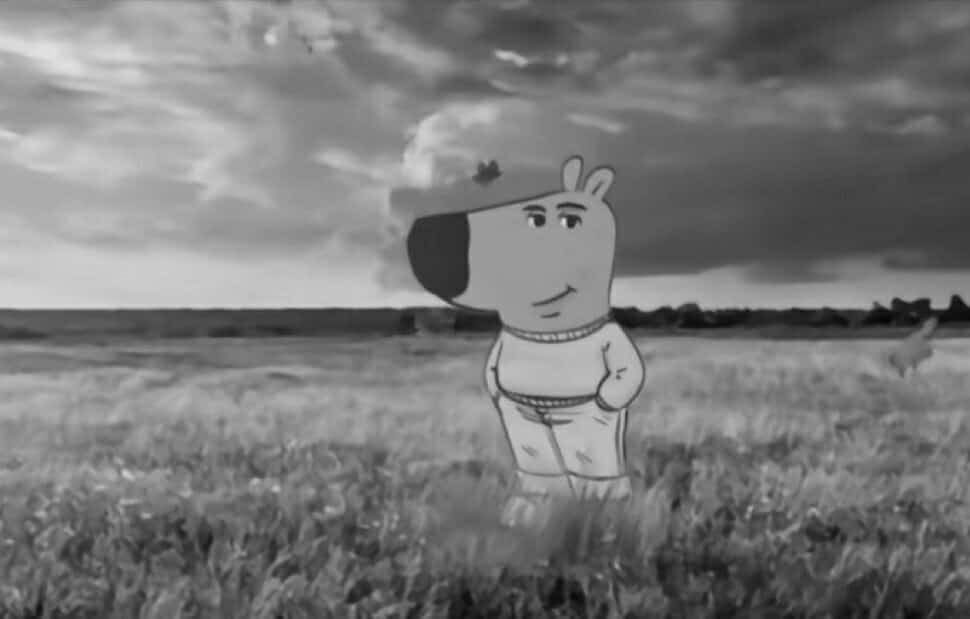

In [ ]:
# Read the image
import cv2
from google.colab.patches import cv2_imshow

image = cv2.imread("/content/drive/MyDrive/elective 2 part 1/chill.jpg")

# Print the shape of the original image (height, width, channels)
print("Original image shape:", image.shape)

# Convert the image to grayscale
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
print("Grayscale image shape:", gray_image.shape)

#chill guy
chill = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
print(chill.shape)
cv2_imshow(chill)

# **2.Visualizing Edge Detection:**


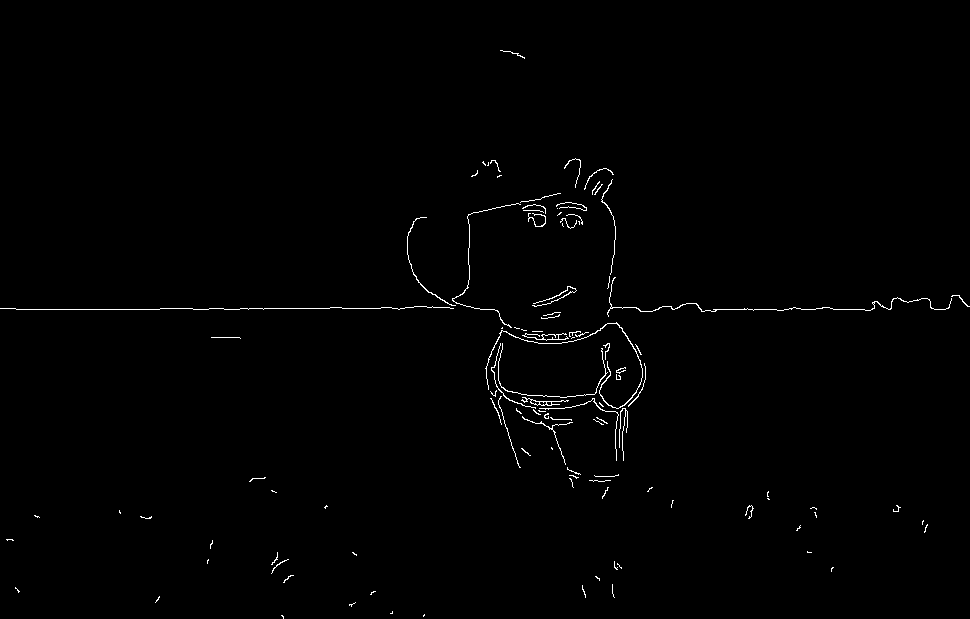

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

image = cv2.imread("/content/drive/MyDrive/elective 2 part 1/chill.jpg")
# cv2_imshow(image)

gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
canny_image = cv2.Canny(gray,150, 200)
# cv2_imshow(canny_image)
cv2_imshow(canny_image)

# **3. Demonstrating Morphological Erosion:**

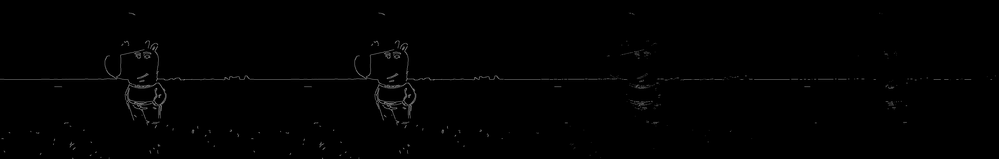

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np


# Erosion
kernel1 = np.ones((1,1), np.uint8)
kernel2 = np.ones((1,2), np.uint8)
kernel3 = np.ones((1,3), np.uint8)

erode_image1 = cv2.erode(canny_image,kernel1, iterations=1)
erode_image2 = cv2.erode(canny_image,kernel2, iterations=2)
erode_image3 = cv2.erode(canny_image,kernel3, iterations=3)

chill = np.hstack([canny_image, erode_image1, erode_image2, erode_image3])
cv2_imshow(chill)


# **4. Demonstrating Morphological Dilation**

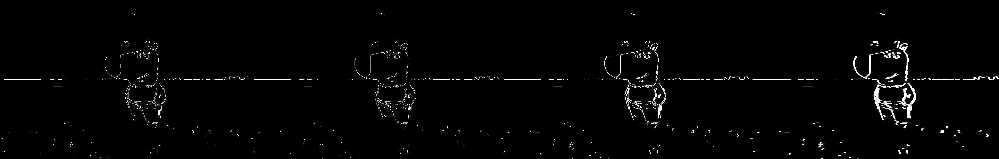

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

kernel1 = np.ones((1,1), np.uint8)
kernel2 = np.ones((1,2), np.uint8)
kernel3 = np.ones((1,3), np.uint8)

dilate_image1 = cv2.dilate(canny_image,kernel1, iterations=1)
dilate_image2 = cv2.dilate(canny_image,kernel2, iterations=2)
dilate_image3 = cv2.dilate(canny_image,kernel3, iterations=3)

chill = np.hstack([canny_image, dilate_image1, dilate_image2, dilate_image3])
cv2_imshow(chill)



# **5. Reducing Noise in Photos**

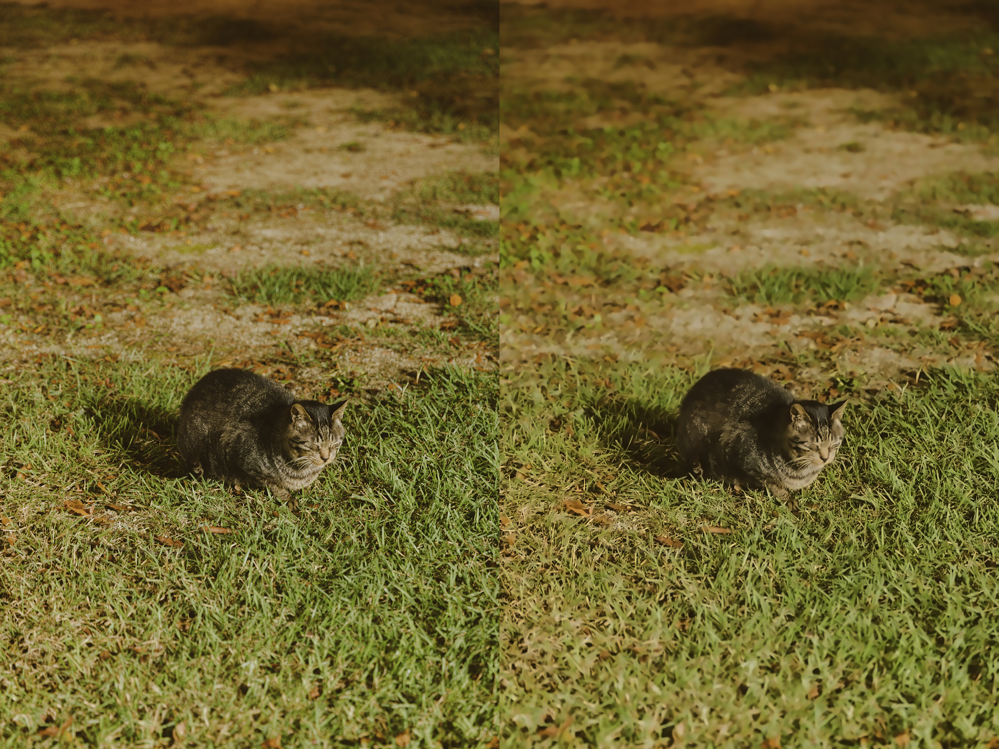

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

image = cv2.imread("cat.jpg")
#cv2_imshow(image)

dst = cv2.fastNlMeansDenoisingColored(image, None, 10, 20, 7, 15)
display = np.hstack((image, dst))
cv2_imshow(display)

# **6. Drawing Geometric Shapes on Images**

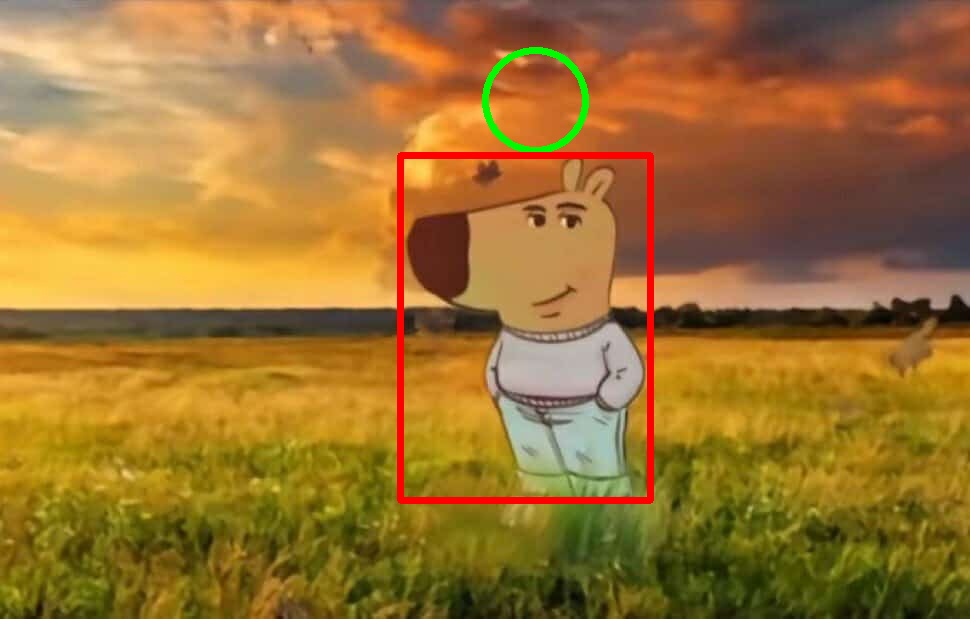

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("/content/drive/MyDrive/elective 2 part 1/chill.jpg")


# Drawing Function
# Draw a Circle
cv2.circle(img, (535,100), 50, (0,250,0),5)
# Draw a Rectangle
cv2.rectangle(img,(400,155),(650,500),(0,0,255),5)
# Displaying the Image
cv2_imshow(img)
image = cv2.imread("chill.jpg")

#  **7. Adding Text to Images**

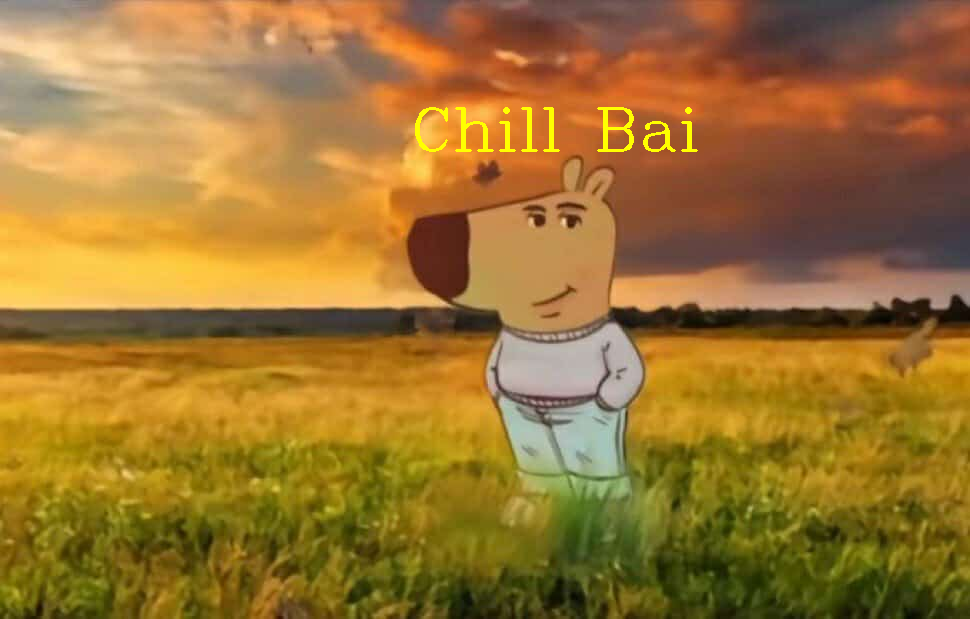

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("/content/drive/MyDrive/elective 2 part 1/chill.jpg")

#Write a Text
cv2.putText(img,"Chill Bai",(410,150),cv2.FONT_HERSHEY_COMPLEX,2,(0,585,600),2)
cv2_imshow(img)





# **8. Isolating Objects by Color**

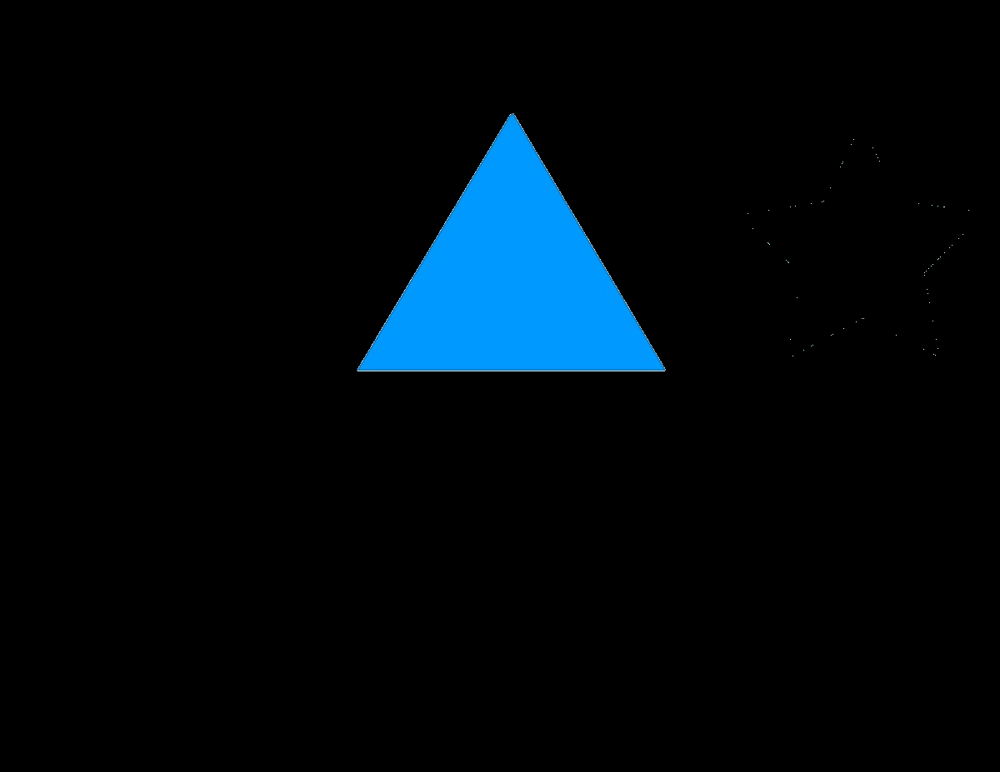

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

#image with shapes
image = cv2.imread("/content/drive/MyDrive/elective 2 part 1/shape.jpg")


hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

#Blue
lower_hue = np.array([90, 50, 70])
upper_hue = np.array([128, 255, 255])
mask = cv2.inRange(hsv, lower_hue, upper_hue)
#cv2_imshow(mask)
result = cv2.bitwise_and(image, image, mask = mask)
cv2_imshow(result)

# **9. Detecting Faces in Group Photos**

The number of faces detected are 5


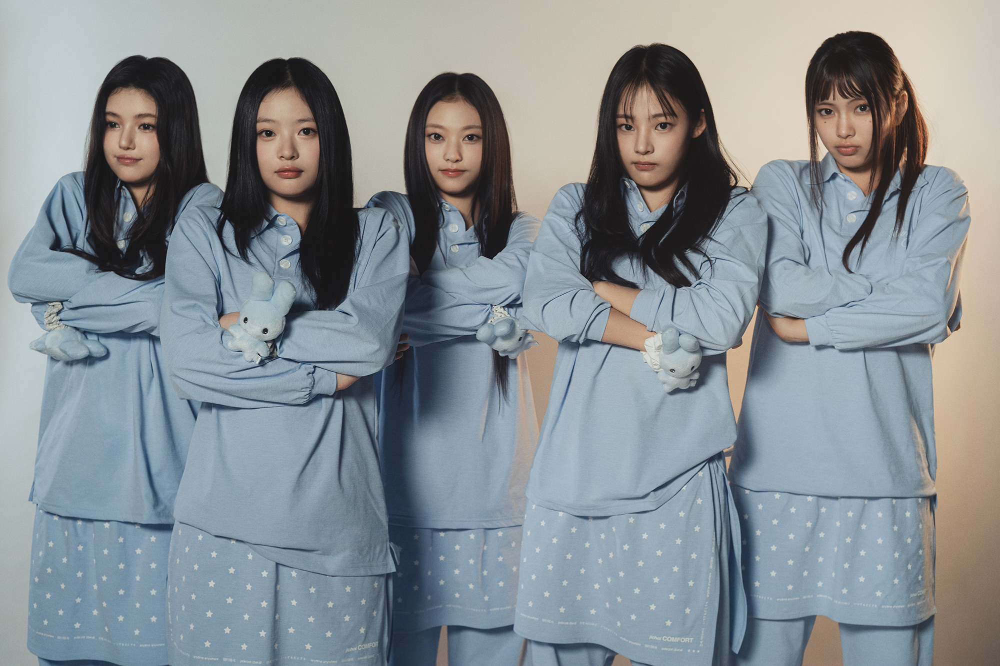

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

face_cascade = cv2.CascadeClassifier("/content/drive/MyDrive/elective 2 part 1/raw.xml")
# img = cv2.imread("images/person.jpg")
img = cv2.imread("/content/drive/MyDrive/elective 2 part 1/sigma.jpg")
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

faces = face_cascade.detectMultiScale(gray,1.3,5)
# print(faces)
num_faces = len(faces)
print("The number of faces detected are", num_faces)

#for (x,y,w,h) in faces:
  #cv2.rectangle(img,(x,y),(x+w,y+h),(0,255,0),3)

cv2_imshow(img)

# **10. Outlining Shapes with Contours**

We found a square


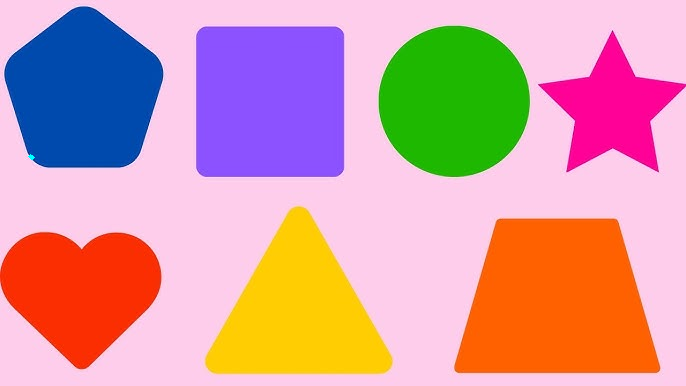

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("/content/drive/MyDrive/elective 2 part 1/ship.jpg")
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

ret, thresh = cv2.threshold(gray,50,255,1)
contours,h = cv2.findContours(thresh,1,2)
# cv2_imshow(thresh)
for cnt in contours:
  approx = cv2.approxPolyDP(cnt,0.01*cv2.arcLength(cnt,True),True)
  n = len(approx)
  if n==10:

    cv2.drawContours(img,[cnt],0,(0,255,255),3)
  elif n==4:
    # this is a Square
    print("We found a square")
    cv2.drawContours(img,[cnt],0,(255,255,0),3)
cv2_imshow(img)

# **11.Tracking a Ball in a Video**

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

cap = cv2.VideoCapture("/content/drive/MyDrive/elective 2 part 1/Ball Bouncing Across the Screen.mp4")
# Get video properties
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS)

# Define the codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter('/content/drive/MyDrive/elective 2 part 1/output_video.mp4', fourcc, fps, (frame_width, frame_height))
ball = []

while cap.isOpened():
  ret, frame = cap.read()
  if ret is False:
    break
  hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
  lower_blue = np.array([110,50,50])
  upper_blue = np.array([130,255,255])
  mask = cv2.inRange(hsv, lower_blue, upper_blue)

  (contours, _) = cv2.findContours(mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

  center = None

  if len(contours) > 0:
    # Find the largest contour
    c = max(contours, key=cv2.contourArea)

    # Get the bounding rectangle
    x, y, w, h = cv2.boundingRect(c)

    # Draw the bounding box around the ball
    cv2.rectangle(frame, (x, y), (x+w, y+h), (149,67,76), 2)  # Adjust thickness as needed

    # Calculate the center coordinates (optional for ball trajectory)
    M = cv2.moments(c)
    try:
      center = (int(M["m10"] / M["m00"]), int(M["m01"] / M["m00"]))
      ball.append(center)  # Optional: store center coordinates for trajectory
    except:
      pass

  # Draw trajectory lines (optional, modify based on ball.append logic)
    if len(ball) > 2:
      for i in range(1, len(ball)):
        cv2.line(frame, ball[i-1], ball[i], (0, 0, 255), 5)

  out.write(frame)

print(ball)
out.release()


[(1, 209), (3, 210), (5, 212), (7, 215), (9, 218), (11, 221), (13, 225), (15, 230), (17, 236), (19, 241), (21, 248), (24, 256), (26, 264), (28, 274), (30, 284), (32, 296), (35, 309), (37, 324), (39, 341), (42, 360), (44, 382), (47, 408), (49, 438), (52, 476), (55, 527), (58, 613), (64, 637), (71, 648), (70, 625), (70, 588), (72, 500), (76, 451), (80, 415), (85, 386), (89, 363), (95, 342), (99, 324), (104, 309), (109, 295), (114, 283), (119, 272), (124, 263), (129, 254), (134, 247), (139, 240), (143, 234), (148, 229), (153, 224), (158, 220), (163, 217), (168, 214), (172, 211), (177, 210), (182, 208), (187, 207), (192, 206), (197, 206), (202, 206), (207, 207), (211, 207), (216, 209), (221, 210), (226, 212), (231, 215), (236, 218), (241, 221), (246, 225), (251, 230), (255, 235), (260, 241), (265, 248), (270, 256), (275, 264), (280, 274), (285, 284), (290, 296), (295, 309), (299, 324), (304, 341), (309, 360), (314, 382), (319, 408), (323, 438), (329, 476), (334, 527), (339, 613), (343, 637

# **12. Highlighting Detected faces**

The number of faces detected are 5


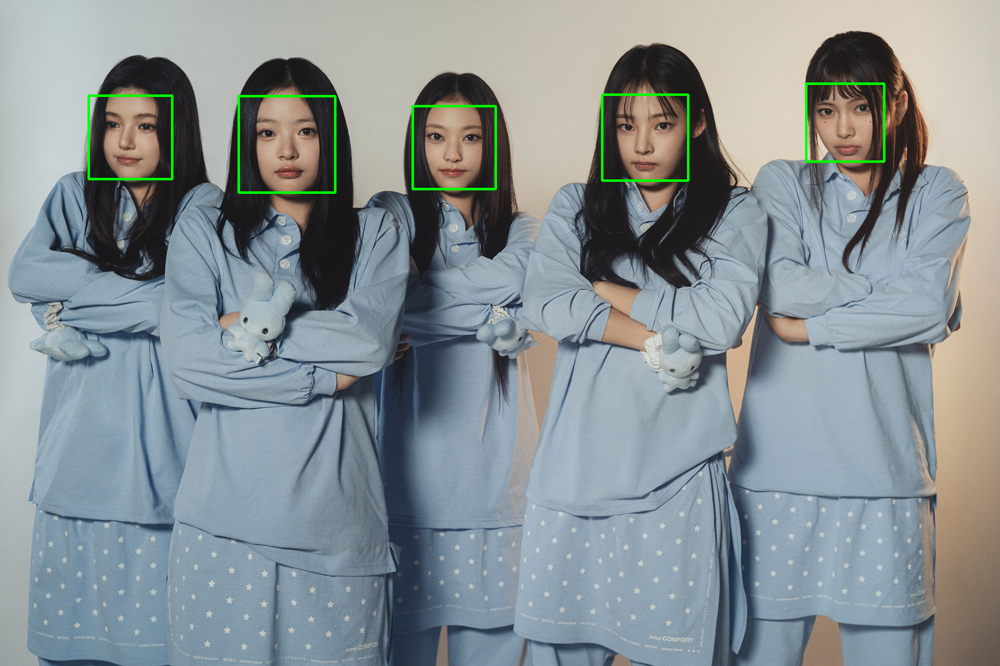

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

face_cascade = cv2.CascadeClassifier("/content/drive/MyDrive/elective 2 part 1/raw.xml")
# img = cv2.imread("images/person.jpg")
img = cv2.imread("/content/drive/MyDrive/elective 2 part 1/sigma.jpg")
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

faces = face_cascade.detectMultiScale(gray,1.3,5)
# print(faces)
num_faces = len(faces)
print("The number of faces detected are", num_faces)

for (x,y,w,h) in faces:
  cv2.rectangle(img,(x,y),(x+w,y+h),(0,255,0),3)

cv2_imshow(img)

# **13. Extracting Contours for Shape Analysis**

In [ ]:
import cv2
import numpy as np

def extract_contours(image_path):
    "Extracts contours from a image."

    img = cv2.imread(image_path)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply thresholding to create a binary image
    thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

    # Find contours
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    return contours

def analyze_contours(contours):
    """Analyzes the extracted contours."


    """

    for cnt in contours:
        # Approximate the contour to a polygon
        approx = cv2.approxPolyDP(cnt, 0.02 * cv2.arcLength(cnt, True), True)

        # Classify the shape based on the number of vertices
        if len(approx) == 3:
            print("Triangle")
        elif len(approx) == 4:
            x, y, w, h = cv2.boundingRect(approx)
            aspect_ratio = float(w)/h
            if 0.95 <= aspect_ratio <= 1.05:
                print("Square")
            else:
                print("Rectangle")
        elif len(approx) == 5:
            print("Pentagon")
        elif len(approx) == 6:
            print("Hexagon")
        else:
            print("Circle")

# Example usage:
image_path = "/content/drive/MyDrive/elective 2 part 1/ship.jpg"  # Replace with your image path
contours = extract_contours(image_path)
analyze_contours(contours)

Circle
Rectangle
Circle
Square
Circle
Hexagon


#  **14. Applying Image Blurring Technique**

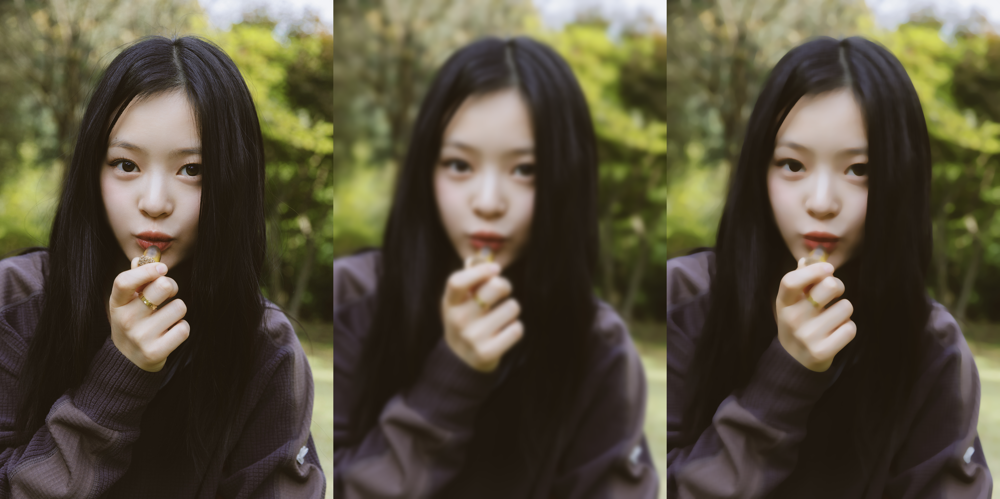

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

# Load the image
image_path = "/content/drive/MyDrive/elective 2 part 1/hanni.jpg"
img = cv2.imread(image_path)

# Apply Gaussian Blur
gaussian_blurred = cv2.GaussianBlur(img, (51, 51), 0)

# Apply Median Blur
median_blurred = cv2.medianBlur(img, 21)

# Display the results
display = np.hstack([img, gaussian_blurred, median_blurred])
cv2_imshow(display)